### Métodos de machine learning con algoritmos de clúster no supervisados, una alternativa de segmentación de las pymes colombianas para plantear estrategias de acuerdo con sus condiciones económicas.

**Durley Yalile Ramírez Mendoza**

**UNIVERSIDAD EAFIT**

**Resumen**

En el presente documento se busca agrupar diez mil un (10.001) pymes colombianas teniendo en cuenta los años 2016, 2017, 2018 y 2019 usando herramientas de machine learning con algoritmos de clúster no supervisados como son los modelos K – Means y clúster Aglomerativo. Estos modelos generarán conglomerados con características financieras similares donde al analizar sus cifras e indicadores se espera que cada clúster tenga una distinción financiera marcada y de esta manera se podrán plantear estrategias de acuerdo al mejor modelo de agrupación según las condiciones económicas de las pymes a las que pertenece cada clúster.


A continuación se describe el código en Python usado para el desarrollo del proyecto:

### 1.Importar librerias

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
%matplotlib inline 

### 1.1 Carga de base de datos

In [2]:
pymes =pd.read_excel('./datos/Datos_Ratios.xlsx')
pymes.head()

,Macrosector,Desc_Macrosector,CATEGORIA,Descripción,SUBCATEGORIA,NOMBRE,NIT,PERIODO,Ingresos_operacionales,Costo_ventas,...,Utilidad_Neta,Margen_Neto,Activo,Pasivo,Patrimonio,Ebitda_,Margen_Ebitda,Indice_endeudamiento,ROA,ROE
0,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2016,310130,4077.0,...,15955,0.051446,3419876,2499818,920058,38816,0.125160,0.730967,0.004665,0.017341
1,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2017,300000,0.0,...,36034,0.120113,3766237,2810145,956092,-70789,-0.235963,0.746141,0.009568,0.037689
2,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2018,300000,NaN,...,16287,0.054290,5050305,4077926,972379,-40105,-0.133683,0.807461,0.003225,0.016750
3,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2019,300000,NaN,...,69527,0.231757,5013624,3971718,1041906,208181,0.693937,0.792185,0.013868,0.066731
4,1,Sector agropecuario,A,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",145,Cría de aves de corral,800000276,2016,321430952,274957420.0,...,268204,0.000834,141586731,94570079,47016652,9848367,0.030639,0.667930,0.001894,0.005704


### 2.Análisis Exploratorio de Datos

### 2.1 Numero de datos y variables

La base de datos corresponde a 4004 entradas o filas y 34 variables o columnas

In [3]:
pymes.shape

(40004, 34)

### 2.2 Numero de empresas

Las 4004 entradas corresponden 1001 empresas en los años 2016, 2017, 2018, 2019.

In [4]:
len(pymes.NIT.unique())

10001

### 2.3 Tipos de variables

In [5]:
pymes.dtypes

Macrosector                    int64
Desc_Macrosector              object
CATEGORIA                     object
Descripción                   object
SUBCATEGORIA                   int64
NOMBRE                        object
NIT                            int64
PERIODO                        int64
Ingresos_operacionales         int64
Costo_ventas                 float64
Utilidad_bruta                 int64
Margen_Bruto                 float64
Otros_ingresos                 int64
Costos_distribución          float64
Gastos_admon                 float64
Otros_gastos                 float64
Otras_ganancias_operdidas    float64
Utilidad_operativa             int64
Margen_operativo             float64
Ing_financieros              float64
Cto_financieros              float64
Utilidad_antes_impuestos       int64
Margen_antes_impuestos       float64
Gasto_impuestos              float64
Utilidad_Neta                  int64
Margen_Neto                  float64
Activo                         int64
P

In [6]:
# se realiza una copia de la base datos para poder hacer cambios y ajustes
pym_total=pymes.copy()

### 2.4 Valores Nulos

Se presentan valores nulos en las variables costo de ventas, costos de distribución, gastos administrativos, otros gastos, otras ganancias o perdidas, ingresos financieros, costos financieros y gasto de impuestos.

In [7]:
pymesmissed=pym_total.isnull()
#columnas con valores nulos y su porcentaje
columnas_connull=[]
# porcentajes por columna de valores nulos
porc_valoresnull=[]
for column in pymesmissed.columns.values.tolist():
    
    if ((pymesmissed[column]).value_counts()[0]*100/len(pymesmissed))<100:
        columnas_connull.append(column)
        porc_valoresnull.append(float("{0:.3f}".format((pymesmissed[column]).value_counts()[1]*100/len(pymesmissed))))
        print(column,"% valores no nulos y nulos")
        print ((pymesmissed[column]).value_counts()*100/len(pymesmissed))
        print("")
print ("lista de columnas con valores nulos: ",columnas_connull)

print ("lista porcentajes con valores nulos: ",porc_valoresnull)

Costo_ventas % valores no nulos y nulos
False    83.084192
True     16.915808
Name: Costo_ventas, dtype: float64

Costos_distribución % valores no nulos y nulos
False    68.108189
True     31.891811
Name: Costos_distribución, dtype: float64

Gastos_admon % valores no nulos y nulos
False    97.947705
True      2.052295
Name: Gastos_admon, dtype: float64

Otros_gastos % valores no nulos y nulos
False    86.631337
True     13.368663
Name: Otros_gastos, dtype: float64

Otras_ganancias_operdidas % valores no nulos y nulos
True     78.967103
False    21.032897
Name: Otras_ganancias_operdidas, dtype: float64

Ing_financieros % valores no nulos y nulos
False    60.211479
True     39.788521
Name: Ing_financieros, dtype: float64

Cto_financieros % valores no nulos y nulos
False    74.815018
True     25.184982
Name: Cto_financieros, dtype: float64

Gasto_impuestos % valores no nulos y nulos
False    92.333267
True      7.666733
Name: Gasto_impuestos, dtype: float64

lista de columnas con valores 

### 2.5 Transformación de los valores nulos

Los valores nulos se convierten en ceros

In [8]:
pym_total=pym_total.fillna(0)
pym_total.isnull().sum()

Macrosector                  0
Desc_Macrosector             0
CATEGORIA                    0
Descripción                  0
SUBCATEGORIA                 0
NOMBRE                       0
NIT                          0
PERIODO                      0
Ingresos_operacionales       0
Costo_ventas                 0
Utilidad_bruta               0
Margen_Bruto                 0
Otros_ingresos               0
Costos_distribución          0
Gastos_admon                 0
Otros_gastos                 0
Otras_ganancias_operdidas    0
Utilidad_operativa           0
Margen_operativo             0
Ing_financieros              0
Cto_financieros              0
Utilidad_antes_impuestos     0
Margen_antes_impuestos       0
Gasto_impuestos              0
Utilidad_Neta                0
Margen_Neto                  0
Activo                       0
Pasivo                       0
Patrimonio                   0
Ebitda_                      0
Margen_Ebitda                0
Indice_endeudamiento         0
ROA     

In [9]:
pym_total.dtypes

Macrosector                    int64
Desc_Macrosector              object
CATEGORIA                     object
Descripción                   object
SUBCATEGORIA                   int64
NOMBRE                        object
NIT                            int64
PERIODO                        int64
Ingresos_operacionales         int64
Costo_ventas                 float64
Utilidad_bruta                 int64
Margen_Bruto                 float64
Otros_ingresos                 int64
Costos_distribución          float64
Gastos_admon                 float64
Otros_gastos                 float64
Otras_ganancias_operdidas    float64
Utilidad_operativa             int64
Margen_operativo             float64
Ing_financieros              float64
Cto_financieros              float64
Utilidad_antes_impuestos       int64
Margen_antes_impuestos       float64
Gasto_impuestos              float64
Utilidad_Neta                  int64
Margen_Neto                  float64
Activo                         int64
P

In [10]:
pymesmissed=pym_total.isnull()
#columnas con valores nulos y su porcentaje
columnas_connull=[]
# porcentajes por columna de valores nulos
porc_valoresnull=[]
for column in pymesmissed.columns.values.tolist():
    
    if ((pymesmissed[column]).value_counts()[0]*100/len(pymesmissed))<100:
        columnas_connull.append(column)
        porc_valoresnull.append(float("{0:.3f}".format((pymesmissed[column]).value_counts()[1]*100/len(pymesmissed))))
        print(column,"% valores no nulos y nulos")
        print ((pymesmissed[column]).value_counts()*100/len(pymesmissed))
        print("")
print ("lista de columnas con valores nulos: ",columnas_connull)

print ("lista porcentajes con valores nulos: ",porc_valoresnull)

lista de columnas con valores nulos:  []
lista porcentajes con valores nulos:  []


### 2.6 Graficas y visualización de variables

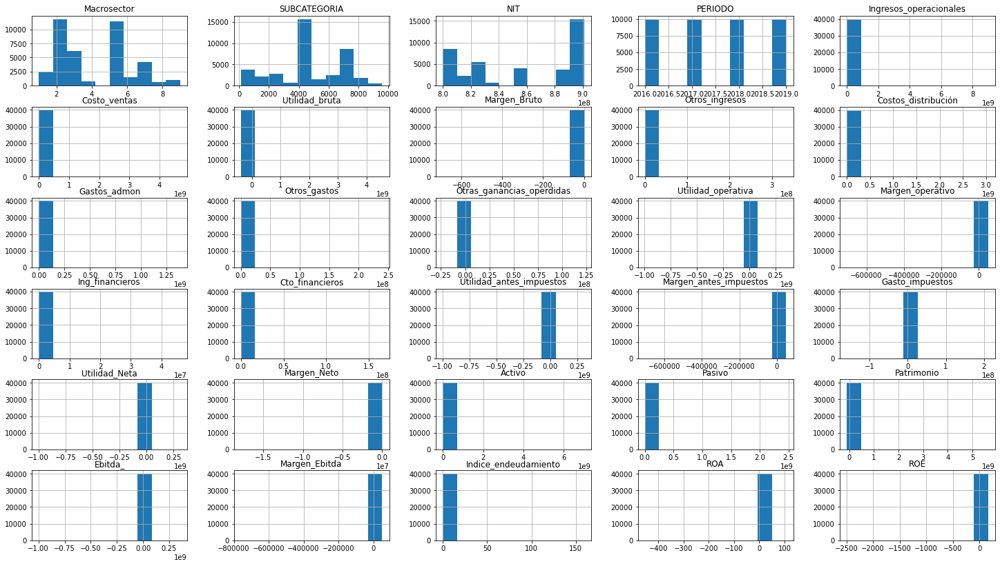

In [11]:
# Histogramas
plt.rcParams["figure.figsize"] = (25,14)
pym_total.hist()
plt.show()

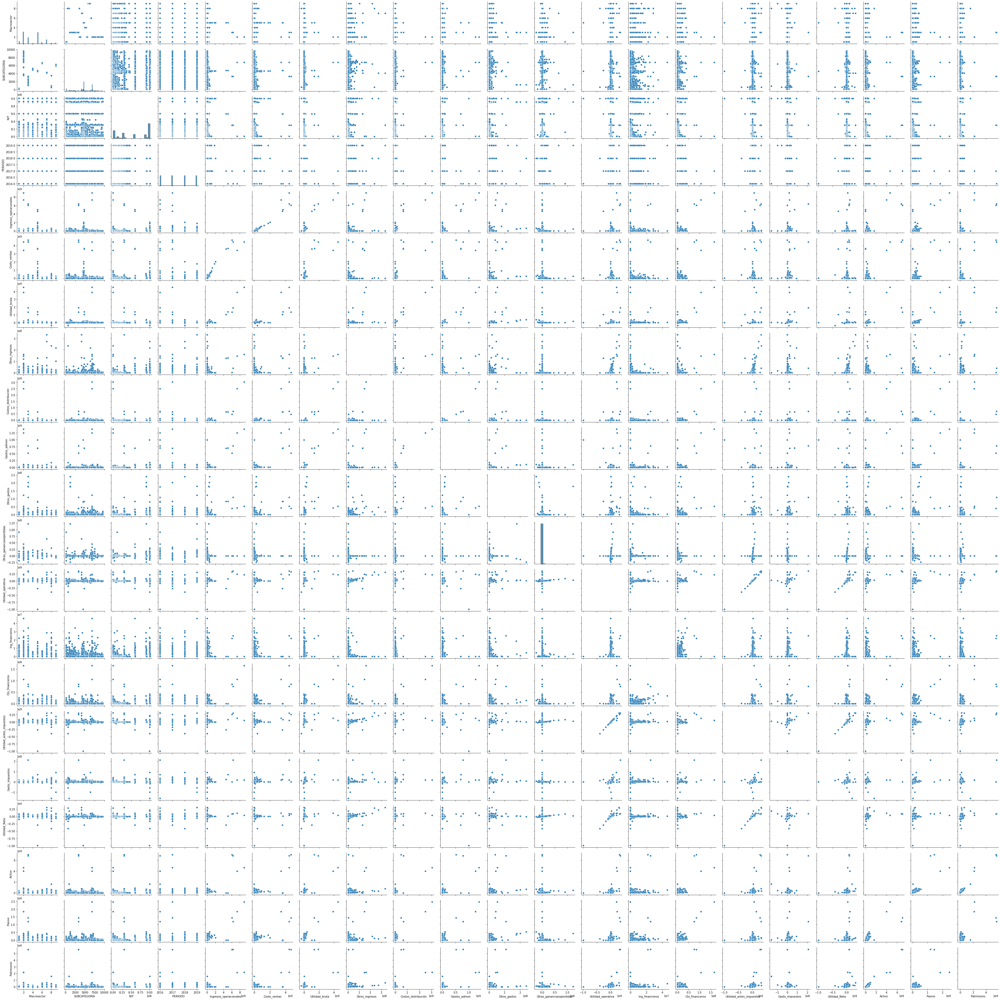

In [19]:
# correlograma para las variables predictoras
sns.pairplot(pym_total, kind="scatter")
plt.show()
# se obervan varias relaciones lineales para analizar

In [12]:
# columnas
pym_total.columns

Index(['Macrosector', 'Desc_Macrosector', 'CATEGORIA', 'Descripción',
       'SUBCATEGORIA', 'NOMBRE', 'NIT', 'PERIODO', 'Ingresos_operacionales',
       'Costo_ventas', 'Utilidad_bruta', 'Margen_Bruto', 'Otros_ingresos',
       'Costos_distribución', 'Gastos_admon', 'Otros_gastos',
       'Otras_ganancias_operdidas', 'Utilidad_operativa', 'Margen_operativo',
       'Ing_financieros', 'Cto_financieros', 'Utilidad_antes_impuestos',
       'Margen_antes_impuestos', 'Gasto_impuestos', 'Utilidad_Neta',
       'Margen_Neto', 'Activo', 'Pasivo', 'Patrimonio', 'Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE'],
      dtype='object')

### 2.7 Variables usadas para el análisis

Se usan los ratios: 'Margen_Bruto','Margen_operativo','Margen_antes_impuestos','Margen_Neto','Ebitda_','Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE'
Con estos ratios se realiza el análisis de cluster

In [14]:
norm=['Margen_Bruto','Margen_operativo','Margen_antes_impuestos','Margen_Neto','Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE']

In [15]:
# Descripción estadistica de las variables
pym_total[norm].describe()

,Margen_Bruto,Margen_operativo,Margen_antes_impuestos,Margen_Neto,Ebitda_,Margen_Ebitda,Indice_endeudamiento,ROA,ROE
count,40004.000000,40004.000000,40004.000000,4.000400e+04,4.000400e+04,40004.000000,40004.000000,40004.000000,40004.000000
mean,0.375370,-66.330572,-70.059246,-5.040509e+02,9.732050e+05,-85.643047,0.531142,0.017429,-0.033721
std,4.159000,5699.524289,6151.573431,8.931566e+04,1.015514e+07,7074.222069,1.254889,2.363035,13.304603
min,-690.953655,-704428.000000,-704428.000000,-1.783311e+07,-9.964076e+08,-759578.000000,0.000000,-452.867472,-2493.777899
25%,0.169148,0.019628,0.009714,3.239875e-03,3.028400e+04,0.004938,0.269141,0.002532,0.007777
50%,0.315824,0.070734,0.051520,3.087238e-02,4.482840e+05,0.054954,0.498212,0.023686,0.057545
75%,0.749898,0.164426,0.135803,8.950329e-02,1.291925e+06,0.141029,0.700747,0.063108,0.152591
max,1.000000,49963.000000,49888.000000,1.689641e+04,3.546446e+08,49963.000000,159.477966,106.306635,163.077837


In [16]:
# se realiza una nueva copia de los datos para evitar perdida de los datos transformados y modificados
pyclus=pym_total.copy()


### 2.8 Correlación de variables

In [17]:


# matriz de correlación
corr_mat =pyclus[norm].corr()


for x in range(len(norm)):
    corr_mat.iloc[x,x] = 0.0
    
corr_mat

,Margen_Bruto,Margen_operativo,Margen_antes_impuestos,Margen_Neto,Ebitda_,Margen_Ebitda,Indice_endeudamiento,ROA,ROE
Margen_Bruto,0.000000,-0.000269,-0.000290,-0.000734,0.014023,-0.000573,-0.006492,0.001604,0.001231
Margen_operativo,-0.000269,0.000000,0.987235,0.469891,0.002410,0.945253,0.000608,0.000672,-0.000084
Margen_antes_impuestos,-0.000290,0.987235,0.000000,0.588646,0.002319,0.924713,0.000508,0.000738,-0.000054
Margen_Neto,-0.000734,0.469891,0.588646,0.000000,0.000851,0.388183,0.000856,0.000707,0.000148
Ebitda_,0.014023,0.002410,0.002319,0.000851,0.000000,0.002422,-0.009724,0.504633,0.473613
Margen_Ebitda,-0.000573,0.945253,0.924713,0.388183,0.002422,0.000000,0.001388,0.000583,-0.000068
Indice_endeudamiento,-0.006492,0.000608,0.000508,0.000856,-0.009724,0.001388,0.000000,0.007892,-0.001992
ROA,0.001604,0.000672,0.000738,0.000707,0.504633,0.000583,0.007892,0.000000,0.907329
ROE,0.001231,-0.000084,-0.000054,0.000148,0.473613,-0.000068,-0.001992,0.907329,0.000000


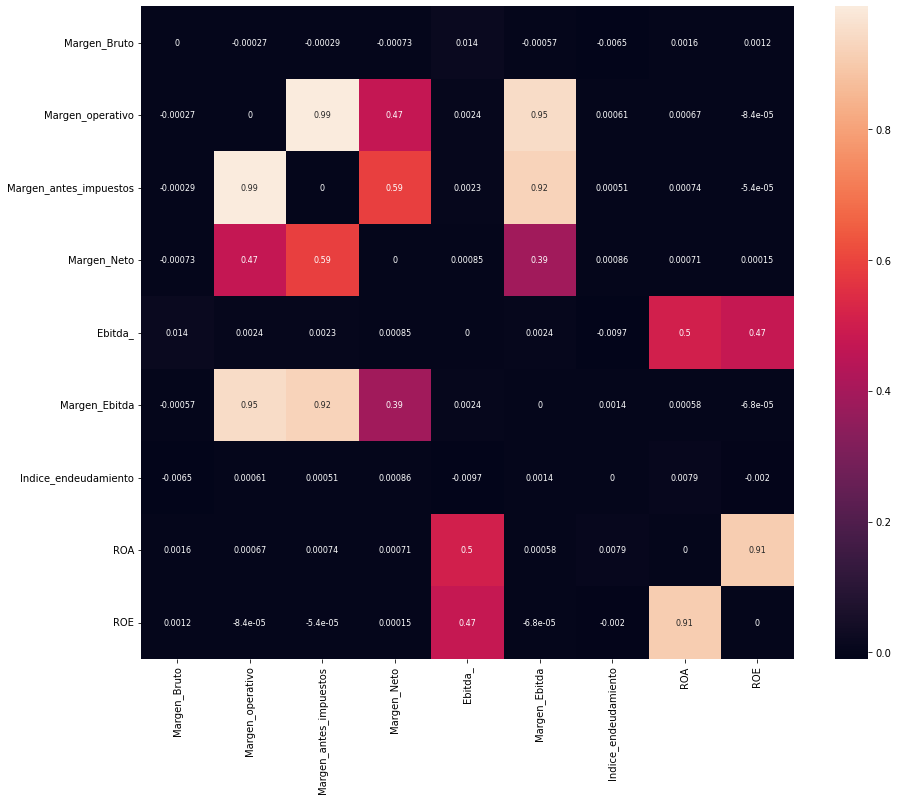

In [18]:
# Matriz de correlación
f, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(corr_mat,square=True,cbar = True, annot = True, annot_kws = {'size': 8} );

In [19]:
# Máxima correlación entre variables
corr_mat.abs().idxmax()

Margen_Bruto                             Ebitda_
Margen_operativo          Margen_antes_impuestos
Margen_antes_impuestos          Margen_operativo
Margen_Neto               Margen_antes_impuestos
Ebitda_                                      ROA
Margen_Ebitda                   Margen_operativo
Indice_endeudamiento                     Ebitda_
ROA                                          ROE
ROE                                          ROA
dtype: object

In [20]:
# Máxima correlacion
corr_mat.abs().max()
# Se oberva que algunas variables tienen muy alta correlación por encima del 90%

Margen_Bruto              0.014023
Margen_operativo          0.987235
Margen_antes_impuestos    0.987235
Margen_Neto               0.588646
Ebitda_                   0.504633
Margen_Ebitda             0.945253
Indice_endeudamiento      0.009724
ROA                       0.907329
ROE                       0.907329
dtype: float64

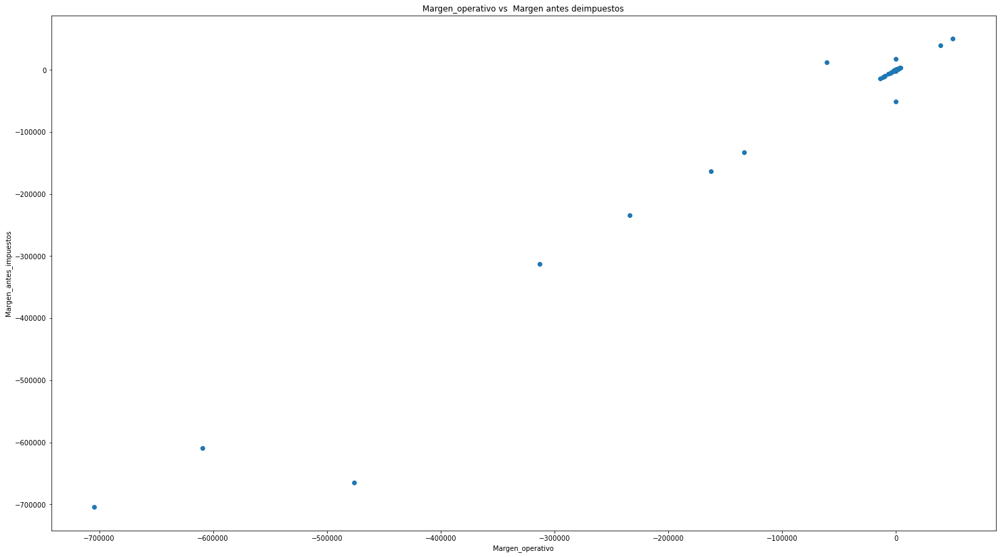

In [21]:
# Grafica donde se observa la fuerte correlacion entre las variables Margen operativo y Margen antes de impuestos
plt.scatter(x="Margen_operativo", y="Margen_antes_impuestos",data=pyclus)
plt.title("Margen_operativo vs  Margen antes deimpuestos")
plt.xlabel("Margen_operativo")
plt.ylabel("Margen_antes_impuestos")
plt.show()

### 3 Análisis de Componentes Principales


### PCA

Principal Component Analysis (PCA) es un método estadístico que permite simplificar la complejidad de espacios muestrales con muchas dimensiones a la vez que conserva su información

Este método de transformación de variables consiste en hacer cumplir las dos condiciones establecidas previamente, pero teniendo en cuenta únicamente la información de los predictores y no necesariamente la relación de estos con la variable de respuesta. En particular, se debe encontrar los vectores $V_{j}$ y los valores $\lambda_{j}$ que cumplan la siguiente ecuación:

$$S_{x}V_{j}=\lambda_{j}V_{j}$$

Donde $S_{x}$ es la matriz de varianza y covarianza de la matriz de predictores ($X$). Finalmente, la matriz de transformación $A$ tiene como columnas a cada uno de los vectores $V_{j}$. Además, $\lambda_{j}$ corresponde a la varianza o información que condensa la variable transformada $Z_{j}$.

El método de PCA permite por lo tanto “condensar” la información aportada por múltiples variables en solo unas pocas componentes.

In [24]:
# se crea una base de datos solo con los ratios:
#'Margen_Bruto','Margen_operativo','Margen_antes_impuestos',
#'Margen_Neto','Ebitda_','Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE' 
pynet=pyclus[norm]

### Standard Scaler
Se estandarizan las variables y se transforman a la misma escala eliminando la media y escalando los datos de forma que su varianza sea igual a 1. Con esto se busca que se le asigne igual importancia a cada variable.

In [25]:
scaler = StandardScaler()
scaler.fit(pynet)
XEscalado=scaler.transform(pynet)

Ahora, calcularemos la matriz 𝐴 usando la siguiente línea de código:

In [26]:
p=len(XEscalado[1,])
pca = PCA(n_components=p).fit(XEscalado)
A=pca.components_

Una vez hecho esto, podemos visualizar la varianza explicada por cada componente. Para ello, haremos el siguiente gráfico:


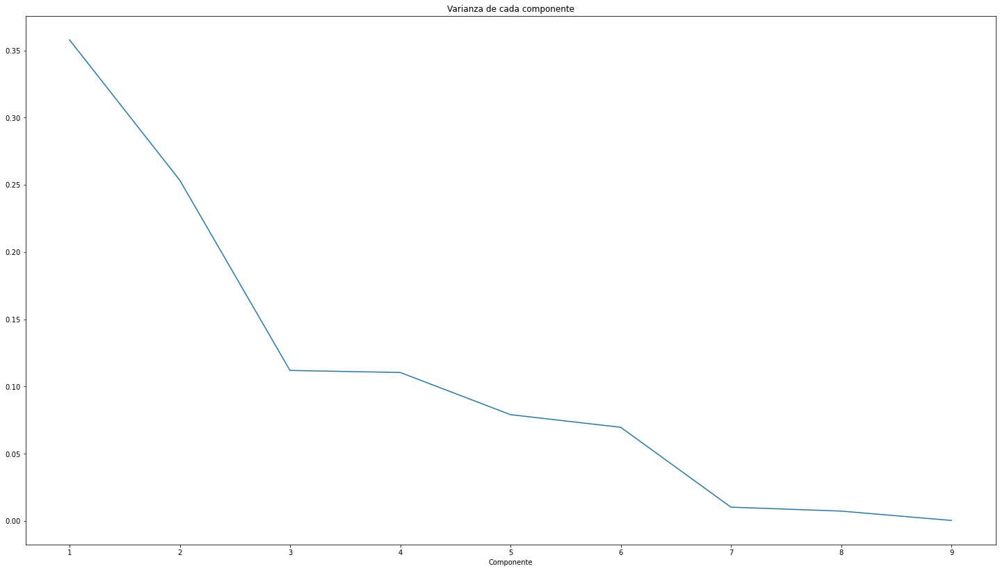

In [27]:
plt.rcParams["figure.figsize"] = (25,14)
varianzaExplicada=pca.explained_variance_
porcentajeVarianzaExplicada=pca.explained_variance_ratio_
plt.plot(range(1,p+1),porcentajeVarianzaExplicada)
plt.xlabel('Componente')
plt.title('Varianza de cada componente')
plt.show()

Como se puede observar, las componentes están ordenadas desde la que más varianza o información contiene, hasta la que menos. Los valores reportados en el anterior gráfico corresponden a los 𝜆𝑗 establecidos con anterioridad.

Sin embargo, generalmente se suele ver el gráfico del porcentaje de la variabilidad explicado por las primeras 𝑗
componentes. Para ello obtener dicho gráfico, ejecutaremos el siguiente código:

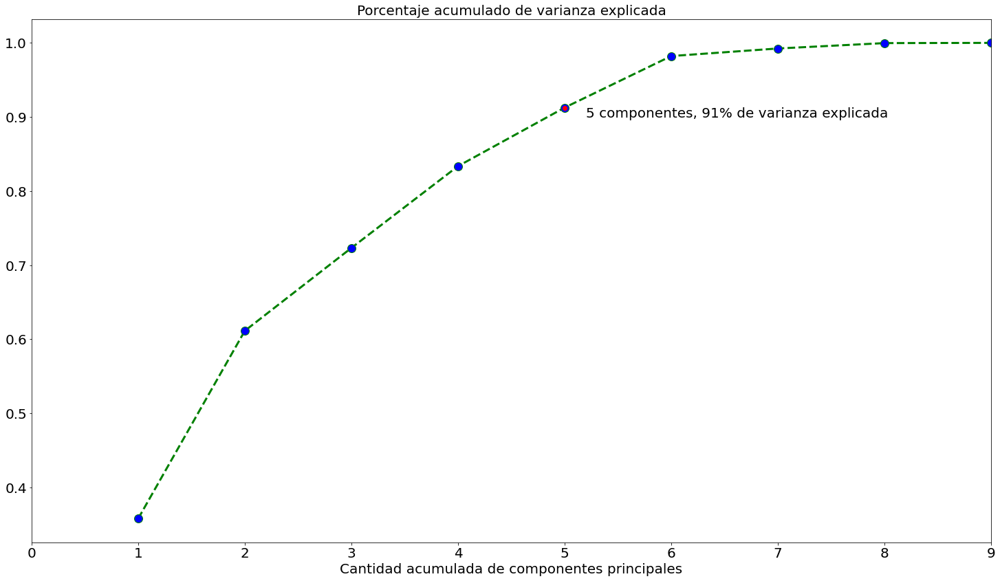

In [54]:
plt.plot(range(1,p+1),np.cumsum(porcentajeVarianzaExplicada),color='green', linestyle='dashed', linewidth = 3,
         marker='o', markerfacecolor='blue', markersize=12)
plt.xlabel('Cantidad acumulada de componentes principales',fontsize=20)
plt.title('Porcentaje acumulado de varianza explicada',fontsize=20)
plt.plot(5,0.9126, marker="o", color="red")
plt.text(5.2,0.90, '5 componentes, 91% de varianza explicada', fontsize=20, color='black')
plt.xlim(0,9)
plt.xticks(fontsize = 20) 
plt.yticks(fontsize = 20) 
plt.show()


Para presentarlo mejor, a continuación se muestran ejemplos de la interpretación del anterior gráfico:
      
      
    La primera componente principal explica alrededor del 35% de la variabilidad o varianza.
    Las primeras dos componentes principales explican alrededor del 61% de la variabilidad.
    Las primeras 3 componentes principales explican alrededor del 72% de la variabilidad.
    Las primeras 4 componentes principales explican alrededor del 83% de la variabilidad.
    Las primeras 5 componentes principales explican cerca del 91% de la variabilidad.
    

De esta manera, se puede ver que con las primeras 5 componentes principales ya se está explicando alrededor del 91% de la variabilidad total. Por lo anterior, escogeremos las 5 primeras componentes principales.



In [55]:
explained_variance =np.cumsum(porcentajeVarianzaExplicada)
explained_variance[4]

0.9126002196336194

In [31]:
# se usan 5 componentes
pca = PCA(n_components=5)
pca.fit(XEscalado)

PCA(n_components=5)

In [32]:
# se escalan y transforman las variables
pca.transform(XEscalado)

array([[-0.02080957,  0.04394546,  0.01200697, -0.21652653,  0.00122939],
       [-0.02078972,  0.0468192 ,  0.01875702, -0.22729312,  0.00112998],
       [-0.02082335,  0.04807276,  0.0531698 , -0.26179262,  0.00120966],
       ...,
       [-0.02131384, -0.06492353,  0.05066076, -0.15789233,  0.00190413],
       [-0.02135139, -0.07680599,  0.02636615, -0.01360855,  0.00287973],
       [-0.02225564, -0.28203849, -0.02003696,  0.03220388,  0.00499648]])

In [33]:
# Se crea el score con los pca trasnformados
scores_pca=pca.transform(XEscalado)

In [34]:
scores_pca[1]

array([-0.02078972,  0.0468192 ,  0.01875702, -0.22729312,  0.00112998])

### 4. Graficas de algunas variables

<AxesSubplot:>

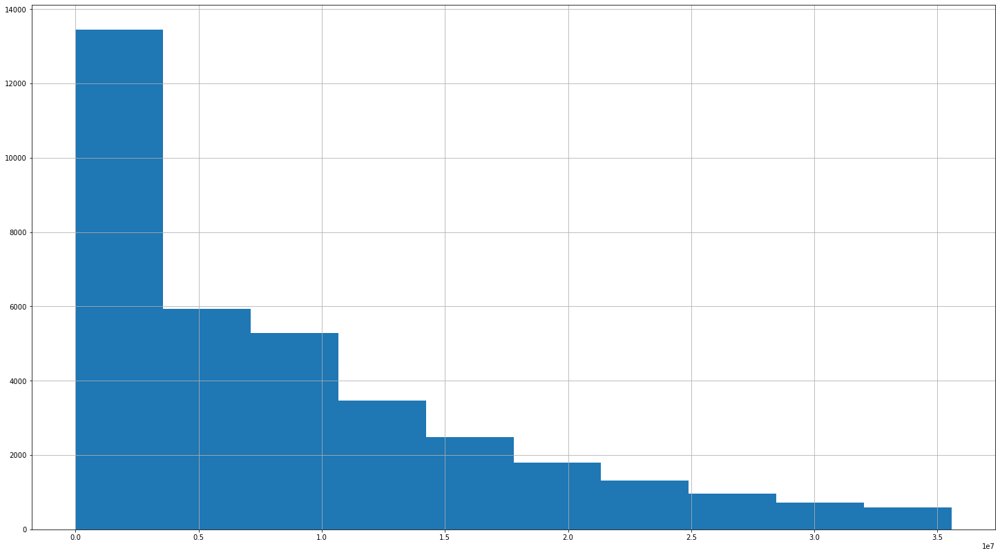

In [53]:
# Ingresos operacionales
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[pynet["Ingresos_operacionales"]<35572666.2]
pyop["Ingresos_operacionales"].hist()


<AxesSubplot:>

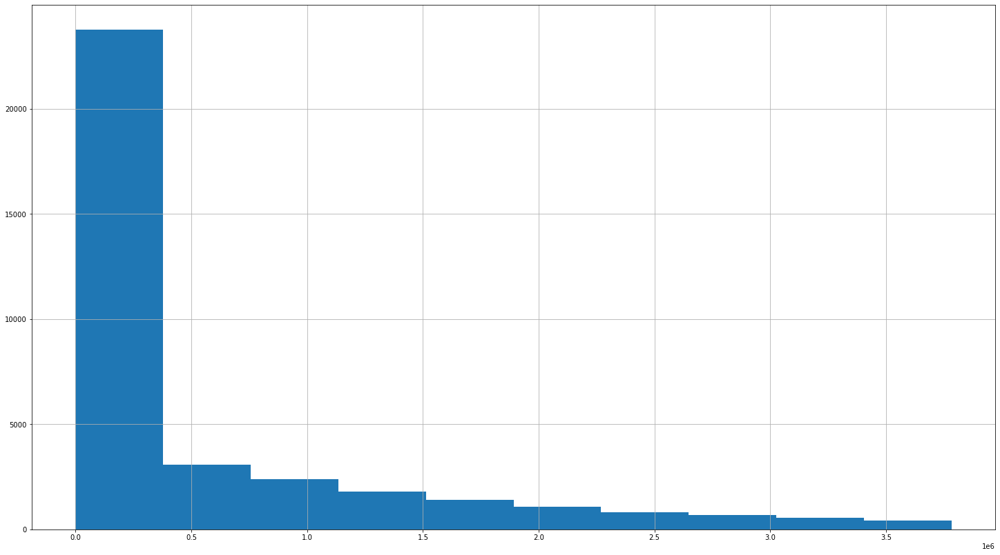

In [54]:
# Costos de distribución
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[(pynet["Costos_distribución"]<3783256.2)]
pyop["Costos_distribución"].hist()

<AxesSubplot:>

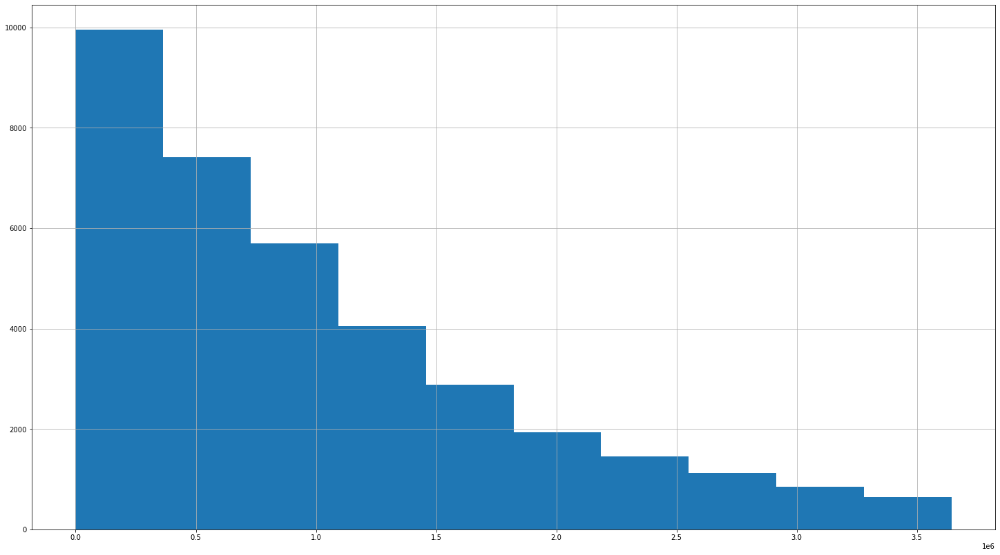

In [55]:
# Gastos administración
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[(pynet["Gastos_admon"]<3644160.5)]
pyop["Gastos_admon"].hist()


<AxesSubplot:>

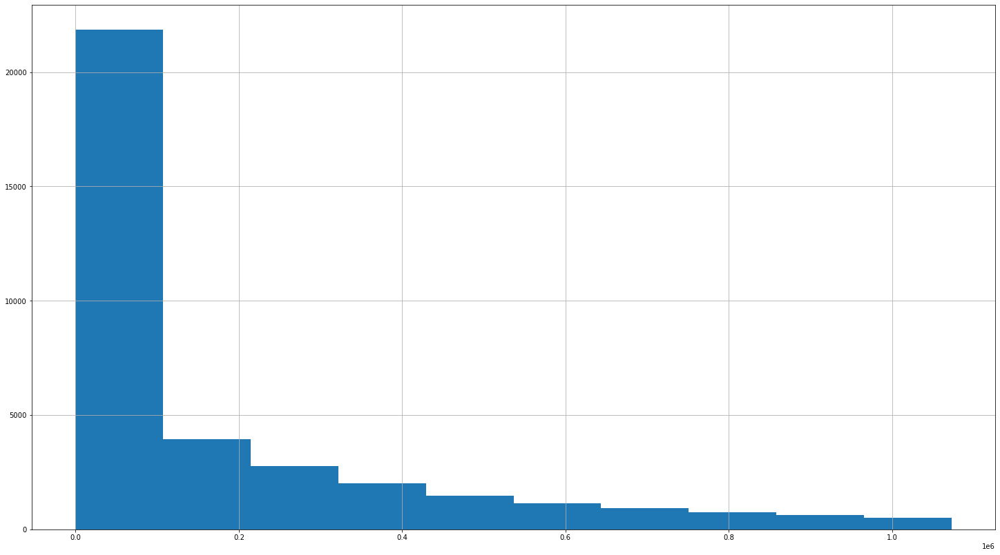

In [56]:
# Costo financieros
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[pynet["Cto_financieros"]<1072960.2]
pyop["Cto_financieros"].hist()


<AxesSubplot:>

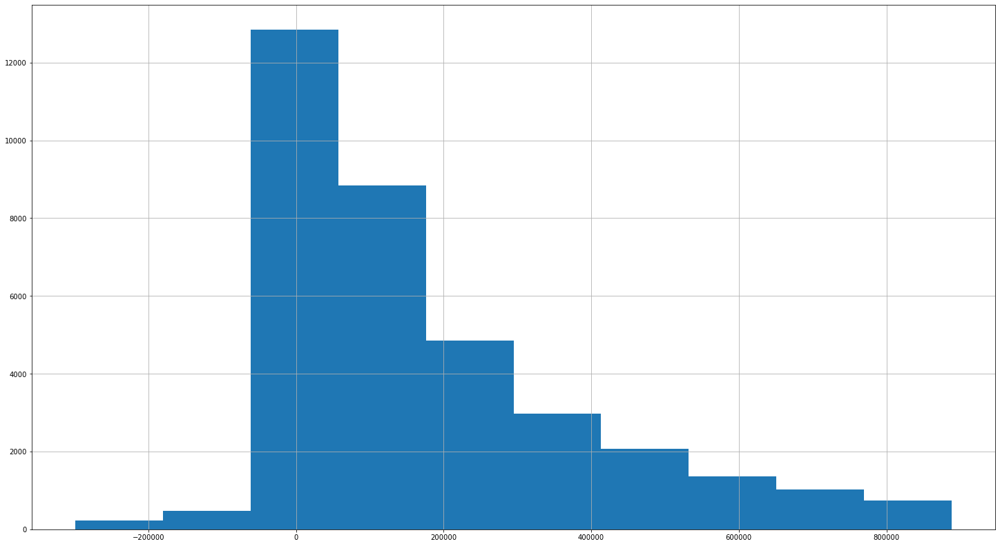

In [57]:
# Gastos de impuestos
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[(pynet["Gasto_impuestos"]<888069.60)&(pynet["Gasto_impuestos"]>-300000)]
pyop["Gasto_impuestos"].hist()

<AxesSubplot:>

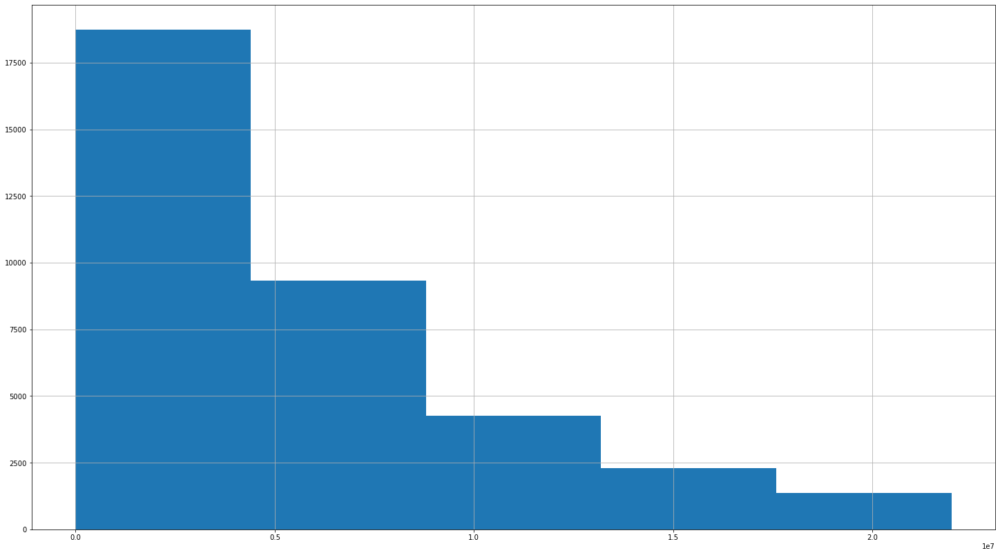

In [58]:
# Pasivo
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[(pynet["Pasivo"]<21989298.5)]
pyop["Pasivo"].hist(bins=5)

<AxesSubplot:>

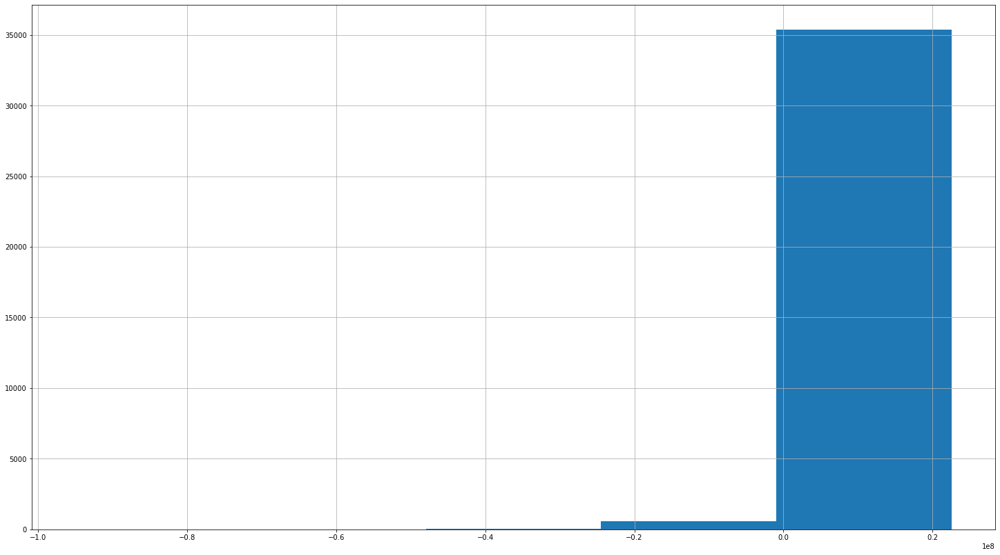

In [59]:
# Patrimonio
plt.rcParams["figure.figsize"] = (25,14)
pyop=pynet[(pynet["Patrimonio"]<22559281.6)]
pyop["Patrimonio"].hist(bins=5)

### 5.Análisis de cluster K Means

El algoritmo K-Means busca agrupar en clústeres o grupos los puntos de datos que tienen una alta similitud entre ellos. En los términos del algoritmo, esta similitud se entiende como lo opuesto de la distancia entre puntos de datos. Cuanto más cerca estén los puntos de datos, más similares y con más probabilidades de pertenecer al mismo clúster serán (Roman, 2019).

El algoritmo de agrupamiento K-Means es un proceso iterativo que mueve los centros de los agrupamientos o centroides a la posición media de sus puntos constituyentes, y reasignando instancias a sus clústeres más cercanos iterativamente hasta que no haya un cambio significativo en el número de clústeres posibles o número de iteraciones alcanzadas (Dangeti, 2017).

La función de K-Means está determinada por la distancia euclidiana (norma cuadrada) entre las observaciones pertenecientes a ese grupo con su respectivo valor centroide.

Pasos del Algoritmo según (Roman, 2019)

    a) Primero, necesitamos elegir k, el número de clústeres que queremos que nos encuentren.
    b) Luego, el algoritmo seleccionará aleatoriamente los centroides de cada grupo.
    c) Se asignará cada punto de datos al centroide más cercano (utilizando la distancia euclídea).
    d) Se calculará la inercia del conglomerado.
    e) Los nuevos centroides se calcularán como la media de los puntos que pertenecen al centroide del paso anterior. En otras palabras, calculando el error cuadrático mínimo de los puntos de datos al centro de cada clúster, moviendo el centro hacia ese punto.
    f) Volver al paso c.

### 5.1 Numero de cluster y calculo de inercia

Se realiza el análisis teniendo en cuenta 100 cluster para analizar la inercia y encontrar el numero optimo de cluster.

In [39]:
# Ajuste del modelo
from sklearn.cluster import KMeans
km_list = list()

for clust in range(1,100):
    km = KMeans(n_clusters=clust, random_state=42)
    km = km.fit(scores_pca)
    
    km_list.append(pd.Series({'clusters': clust, 
                              'inertia': km.inertia_,
                              'model': km}))

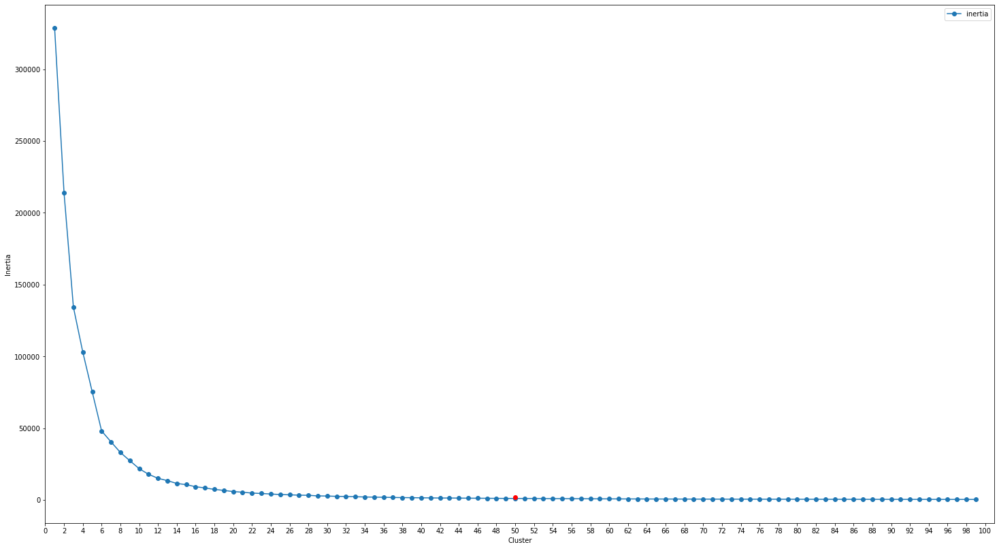

In [55]:
plot_data = (pd.concat(km_list, axis=1)
             .T
             [['clusters','inertia']]
             .set_index('clusters'))

ax = plot_data.plot(marker='o',ls='-')
ax.set_xticks(range(0,101,2))
ax.set_xlim(0,101)
plt.plot(50,2000, marker="o", color="red")
ax.set(xlabel='Cluster', ylabel='Inertia');

Se eligen 50 clúster como numero optimo. Estos 50 clúster se toman para crear una mejor agrupación teniendo en cuenta que son 1001 empresas y se requiere agrupar de la mejor manera, sin embargo se observa que a partir de 12 clúster la disminución de la inercia se mantiene constante.

In [62]:
from sklearn.cluster import KMeans 
from sklearn.datasets import make_blobs 
clusterNum = 50
k_means = KMeans(init = "k-means++", n_clusters = clusterNum, n_init = 12, max_iter=300)
k_means.fit(scores_pca)
labels = k_means.labels_
print(labels)

[47 47 47 ... 47 17 33]


In [63]:
# se crea la nueva variable con los cluster para cada empresa
pyclus["Cluster"] = labels
pyclus.head()

,Macrosector,Desc_Macrosector,CATEGORIA,Descripción,SUBCATEGORIA,NOMBRE,NIT,PERIODO,Ingresos_operacionales,Costo_ventas,...,Margen_Neto,Activo,Pasivo,Patrimonio,Ebitda_,Margen_Ebitda,Indice_endeudamiento,ROA,ROE,Cluster
0,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2016,310130,4077.0,...,0.051446,3419876,2499818,920058,38816,0.125160,0.730967,0.004665,0.017341,47
1,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2017,300000,0.0,...,0.120113,3766237,2810145,956092,-70789,-0.235963,0.746141,0.009568,0.037689,47
2,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2018,300000,0.0,...,0.054290,5050305,4077926,972379,-40105,-0.133683,0.807461,0.003225,0.016750,47
3,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2019,300000,0.0,...,0.231757,5013624,3971718,1041906,208181,0.693937,0.792185,0.013868,0.066731,47
4,1,Sector agropecuario,A,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",145,Cría de aves de corral,800000276,2016,321430952,274957420.0,...,0.000834,141586731,94570079,47016652,9848367,0.030639,0.667930,0.001894,0.005704,33


In [64]:
# se ordenan los 50 clúster de acuerdo con su estadistica y percentiles
pymes_estadistica=pyclus.groupby('Cluster').describe(percentiles=[0.25,0.5,0.75,0.9])
pymes_estadistica

Macrosector                                                      \
              count      mean       std  min   25%  50%   75%  90%  max   
Cluster                                                                   
0             528.0  4.151515  2.236441  1.0  2.00  4.0  5.00  8.0  9.0   
1               1.0  7.000000       NaN  7.0  7.00  7.0  7.00  7.0  7.0   
2               1.0  5.000000       NaN  5.0  5.00  5.0  5.00  5.0  5.0   
3               1.0  2.000000       NaN  2.0  2.00  2.0  2.00  2.0  2.0   
4               4.0  1.000000  0.000000  1.0  1.00  1.0  1.00  1.0  1.0   
5               1.0  8.000000       NaN  8.0  8.00  8.0  8.00  8.0  8.0   
6               1.0  8.000000       NaN  8.0  8.00  8.0  8.00  8.0  8.0   
7               2.0  4.500000  2.121320  3.0  3.75  4.5  5.25  5.7  6.0   
8               1.0  2.000000       NaN  2.0  2.00  2.0  2.00  2.0  2.0   
9               1.0  3.000000       NaN  3.0  3.00  3.0  3.00  3.0  3.0   
10             12.0  4.750000  2.050499  2.0  2.75  5.0  7.00  7.0  7.0   
11           3169.0  2.963395  1.930921  1.0  2.00  2.0  3.00  6.0  9.0   
12              2.0  4.000000  2.828427  2.0  3.00  4.0  5.00  5.6  6.0   
13             11.0  4.909091  2.625054  2.0  2.50  5.0  6.50  9.0  9.0   
14             11.0  4.636364  2.802596  1.0  2.00  4.0  7.50  8.0  8.0   
15              9.0  5.333333  2.121320  2.0  4.00  5.0  7.00  8.0  8.0   
16              1.0  7.000000       NaN  7.0  7.00  7.0  7.00  7.0  7.0   
17           7584.0  4.380142  1.773434  1.0  3.00  5.0  5.00  7.0  9.0   
18              1.0  2.000000       NaN  2.0  2.00  2.0  2.00  2.0  2.0   
19              3.0  3.666667  3.785939  1.0  1.50  2.0  5.00  6.8  8.0   
20              1.0  8.000000       NaN  8.0  8.00  8.0  8.00  8.0  8.0   
21            122.0  3.729508  2.104842  1.0  2.00  3.0  5.00  7.0  9.0   
22             58.0  3.948276  1.771335  2.0  2.00  5.0  5.00  6.0  9.0   
23              2.0  4.500000  3.535534  2.0  3.25  4.5  5.75  6.5  7.0   
24              1.0  5.000000       NaN  5.0  5.00  5.0  5.00  5.0  5.0   
25           7582.0  4.192429  1.900515  1.0  3.00  5.0  5.00  7.0  9.0   
26              1.0  1.000000       NaN  1.0  1.00  1.0  1.00  1.0  1.0   
27              5.0  5.600000  3.361547  2.0  2.00  7.0  8.00  8.6  9.0   
28              3.0  5.000000  3.000000  2.0  3.50  5.0  6.50  7.4  8.0   
29            386.0  4.119171  2.111513  1.0  2.00  4.0  5.00  7.0  9.0   
30             23.0  5.043478  2.305690  2.0  2.50  5.0  7.00  8.0  9.0   
31              1.0  3.000000       NaN  3.0  3.00  3.0  3.00  3.0  3.0   
32              7.0  5.142857  3.236694  2.0  2.00  5.0  8.00  9.0  9.0   
33           1953.0  4.444956  1.954442  1.0  3.00  5.0  5.00  7.0  9.0   
34              2.0  4.500000  3.535534  2.0  3.25  4.5  5.75  6.5  7.0   
35            480.0  4.160417  2.206769  1.0  2.00  4.0  6.00  7.0  9.0   
36             29.0  4.275862  2.950745  1.0  2.00  2.0  7.00  8.0  9.0   
37             37.0  3.864865  2.070456  1.0  2.00  3.0  5.00  7.0  8.0   
38              3.0  5.666667  3.214550  2.0  4.50  7.0  7.50  7.8  8.0   
39           4698.0  3.699021  2.076072  1.0  2.00  3.0  5.00  7.0  9.0   
40              1.0  7.000000       NaN  7.0  7.00  7.0  7.00  7.0  7.0   
41              3.0  6.000000  2.645751  3.0  5.00  7.0  7.50  7.8  8.0   
42           5022.0  4.639188  2.038086  1.0  3.00  5.0  7.00  7.0  9.0   
43           4200.0  2.831429  1.785113  1.0  2.00  2.0  2.00  6.0  9.0   
44             15.0  4.733333  2.313521  2.0  2.50  5.0  7.00  7.0  9.0   
45            119.0  4.554622  2.338685  1.0  2.00  5.0  6.00  8.0  9.0   
46              2.0  9.000000  0.000000  9.0  9.00  9.0  9.00  9.0  9.0   
47           2250.0  3.248444  2.046385  1.0  2.00  2.0  5.00  7.0  9.0   
48            125.0  3.736000  2.024623  1.0  2.00  3.0  5.00  7.0  9.0   
49           1529.0  3.926095  2.191525  1.0  2.00  3.0  5.00  7.0  9.0   

        SUBCATEGORIA  ...       

In [71]:
# se guarda la nueva base de datos con la variable cluster usando el metodo kmeans
pymes_estadistica.to_excel('pymes_estadistica_kmeans_sratios.xlsx', sheet_name='kmeans')

In [66]:
# se copia la base de datos para insertar las 5 componentes principales en la base de datos
py_pca=pyclus.copy()

In [67]:
df_pca_cluster=pd.concat([py_pca.reset_index(drop=True),pd.DataFrame(scores_pca)],axis=1)

In [68]:
# se crean las 5 variables con las 5 componentes principales 
df_pca_cluster.columns.values[-5:]=["PCA_1","PCA_2","PCA_3","PCA_4","PCA_5"]
df_pca_cluster.head()

,Macrosector,Desc_Macrosector,CATEGORIA,Descripción,SUBCATEGORIA,NOMBRE,NIT,PERIODO,Ingresos_operacionales,Costo_ventas,...,Margen_Ebitda,Indice_endeudamiento,ROA,ROE,Cluster,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5
0,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2016,310130,4077.0,...,0.125160,0.730967,0.004665,0.017341,47,-0.020810,0.043945,0.012007,-0.216527,0.001229
1,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2017,300000,0.0,...,-0.235963,0.746141,0.009568,0.037689,47,-0.020790,0.046819,0.018757,-0.227293,0.001130
2,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2018,300000,0.0,...,-0.133683,0.807461,0.003225,0.016750,47,-0.020823,0.048073,0.053170,-0.261793,0.001210
3,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2019,300000,0.0,...,0.693937,0.792185,0.013868,0.066731,47,-0.021013,0.031303,0.043883,-0.253171,0.001417
4,1,Sector agropecuario,A,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",145,Cría de aves de corral,800000276,2016,321430952,274957420.0,...,0.030639,0.667930,0.001894,0.005704,33,-0.023233,-0.412560,0.087197,-0.037415,0.008790


In [69]:
# tipos de variables con la información completa de variables, cluster k means y componentes principales
df_pca_cluster.dtypes

Macrosector                    int64
Desc_Macrosector              object
CATEGORIA                     object
Descripción                   object
SUBCATEGORIA                   int64
NOMBRE                        object
NIT                            int64
PERIODO                        int64
Ingresos_operacionales         int64
Costo_ventas                 float64
Utilidad_bruta                 int64
Margen_Bruto                 float64
Otros_ingresos                 int64
Costos_distribución          float64
Gastos_admon                 float64
Otros_gastos                 float64
Otras_ganancias_operdidas    float64
Utilidad_operativa             int64
Margen_operativo             float64
Ing_financieros              float64
Cto_financieros              float64
Utilidad_antes_impuestos       int64
Margen_antes_impuestos       float64
Gasto_impuestos              float64
Utilidad_Neta                  int64
Margen_Neto                  float64
Activo                         int64
P

In [78]:
df_pca_cluster.columns

Index(['Macrosector', 'Desc_Macrosector', 'CATEGORIA', 'Descripción',
       'SUBCATEGORIA', 'NOMBRE', 'NIT', 'PERIODO', 'Ingresos_operacionales',
       'Costo_ventas', 'Utilidad_bruta', 'Margen_Bruto', 'Otros_ingresos',
       'Costos_distribución', 'Gastos_admon', 'Otros_gastos',
       'Otras_ganancias_operdidas', 'Utilidad_operativa', 'Margen_operativo',
       'Ing_financieros', 'Cto_financieros', 'Utilidad_antes_impuestos',
       'Margen_antes_impuestos', 'Gasto_impuestos', 'Utilidad_Neta',
       'Margen_Neto', 'Activo', 'Pasivo', 'Patrimonio', 'Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE', 'Cluster',
       'PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5'],
      dtype='object')

In [79]:
norm

['Margen_Bruto',
 'Margen_operativo',
 'Margen_antes_impuestos',
 'Margen_Neto',
 'Ebitda_',
 'Margen_Ebitda',
 'Indice_endeudamiento',
 'ROA',
 'ROE']

In [80]:
norm2=['Margen_Bruto',
 'Margen_operativo',
 'Margen_antes_impuestos',
 'Margen_Neto',
 'Ebitda_',
 'Margen_Ebitda',
 'Indice_endeudamiento',
 'ROA',
 'ROE','PCA_1',
       'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5']

In [90]:
# matriz de correlación de componentes principales
corr_mat2 =df_pca_cluster[norm2].corr()

for x in range(len(norm2)):
    corr_mat2.iloc[x,x] = 0.0
    
corr_mat2.iloc[9:,:9]



,Margen_Bruto,Margen_operativo,Margen_antes_impuestos,Margen_Neto,Ebitda_,Margen_Ebitda,Indice_endeudamiento,ROA,ROE
PCA_1,0.000672,-0.975280,-0.992726,-0.633725,-0.004475,-0.939319,-0.001317,-0.002958,-0.002114
PCA_2,-0.009947,0.002406,0.002458,0.001611,-0.717757,0.002306,0.001138,-0.944668,-0.934500
PCA_3,-0.707698,-0.001009,-0.000911,0.001217,-0.033280,-0.000248,0.710331,0.019998,0.013740
PCA_4,-0.706044,0.000101,0.000267,0.000598,0.000213,-0.000325,-0.703537,-0.000750,0.007254
PCA_5,-0.001460,0.186408,0.046866,-0.772538,0.006333,0.278110,0.000703,-0.002327,-0.002537


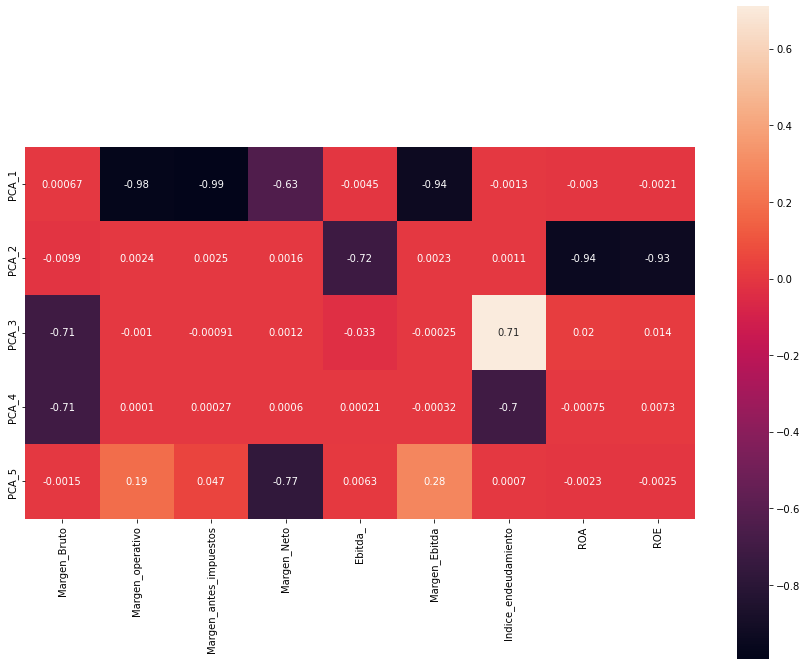

In [91]:
f, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(corr_mat2.iloc[9:,:9],square=True,cbar = True, annot = True, annot_kws = {'size': 10} );

In [189]:
# Cluster y cantidad de periodos por cada nit
Paglo_cluster=df_pca_cluster[["NIT","Cluster","PERIODO"]].groupby(["NIT","Cluster"],as_index=False).count()
Paglo_cluster.rename(columns={'PERIODO':'CANTIDAD_PERIODOS'},
               inplace=True)
Paglo_cluster.tail(30)

,NIT,Cluster,CANTIDAD_PERIODOS
15391,901003985,0,2
15392,901003985,9,2
15393,901014567,9,4
15394,901033073,0,1
15395,901033073,28,1
15396,901033073,39,2
15397,901033282,0,2
15398,901033282,9,1
15399,901033282,29,1
15400,901033316,0,3


In [104]:
pyclus.columns

Index(['Macrosector', 'Desc_Macrosector', 'CATEGORIA', 'Descripción',
       'SUBCATEGORIA', 'NOMBRE', 'NIT', 'PERIODO', 'Ingresos_operacionales',
       'Costo_ventas', 'Utilidad_bruta', 'Margen_Bruto', 'Otros_ingresos',
       'Costos_distribución', 'Gastos_admon', 'Otros_gastos',
       'Otras_ganancias_operdidas', 'Utilidad_operativa', 'Margen_operativo',
       'Ing_financieros', 'Cto_financieros', 'Utilidad_antes_impuestos',
       'Margen_antes_impuestos', 'Gasto_impuestos', 'Utilidad_Neta',
       'Margen_Neto', 'Activo', 'Pasivo', 'Patrimonio', 'Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE', 'Cluster'],
      dtype='object')

In [105]:
norm3=["Cluster",'Ingresos_operacionales',
       'Costo_ventas', 'Utilidad_bruta', 'Margen_Bruto', 'Otros_ingresos',
       'Costos_distribución', 'Gastos_admon', 'Otros_gastos',
       'Otras_ganancias_operdidas', 'Utilidad_operativa', 'Margen_operativo',
       'Ing_financieros', 'Cto_financieros', 'Utilidad_antes_impuestos',
       'Margen_antes_impuestos', 'Gasto_impuestos', 'Utilidad_Neta',
       'Margen_Neto', 'Activo', 'Pasivo', 'Patrimonio', 'Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE','PCA_1',
       'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5']

In [106]:
# Estadistica y percentiles para los 50 cluster y sus componentes principales
pymes_estadistica_clus=df_pca_cluster[norm3].groupby('Cluster').describe(percentiles=[0.75,0.9])
pymes_estadistica_clus

Ingresos_operacionales                                          \
                         count          mean           std         min   
Cluster                                                                  
0                        528.0  2.229837e+07  4.918107e+07         0.0   
1                          1.0  1.000000e+00           NaN         1.0   
2                          1.0  1.566311e+07           NaN  15663111.0   
3                          1.0  1.000000e+00           NaN         1.0   
4                          4.0  0.000000e+00  0.000000e+00         0.0   
5                          1.0  7.099000e+03           NaN      7099.0   
6                          1.0  3.300000e+02           NaN       330.0   
7                          2.0  1.132148e+07  9.545794e+06   4571580.0   
8                          1.0  1.000000e+00           NaN         1.0   
9                          1.0  4.054500e+04           NaN     40545.0   
10                        12.0  1.442477e+05  2.744580e+05         0.0   
11                      3169.0  3.597436e+06  6.138097e+06       432.0   
12                         2.0  6.000000e+00  7.071068e+00         1.0   
13                        11.0  5.274738e+08  1.509895e+09         0.0   
14                        11.0  5.496647e+05  1.150660e+06       500.0   
15                         9.0  8.368928e+06  1.198719e+07         0.0   
16                         1.0  1.000000e+00           NaN         1.0   
17                      7584.0  2.036908e+07  2.593279e+07         0.0   
18                         1.0  3.866330e+05           NaN    386633.0   
19                         3.0  3.603733e+04  3.182126e+04       500.0   
20                         1.0  7.948424e+07           NaN  79484241.0   
21                       122.0  1.097347e+08  1.552832e+08         0.0   
22                        58.0  3.386742e+06  1.078152e+07         0.0   
23                         2.0  1.000000e+00  0.000000e+00         1.0   
24                         1.0  1.000000e+00           NaN         1.0   
25                      7582.0  1.526769e+07  1.975023e+07         0.0   
26                         1.0  5.000000e+02           NaN       500.0   
27                         5.0  3.284879e+09  4.483398e+09  10217838.0   
28                         3.0  1.565475e+09  2.667018e+09  16288885.0   
29                       386.0  7.686875e+06  1.796829e+07         0.0   
30                        23.0  3.996164e+07  5.317572e+07         0.0   
31                         1.0  5.000000e+02           NaN       500.0   
32                         7.0  4.876713e+05  6.856835e+05         0.0   
33                      1953.0  5.878685e+07  6.059761e+07         0.0   
34                         2.0  1.000000e+00  0.000000e+00         1.0   
35                       480.0  7.947728e+07  1.246469e+08         0.0   
36                        29.0  3.244788e+05  5.180651e+05      1722.0   
37                        37.0  3.278744e+08  1.006483e+09         0.0   
38                         3.0  1.630902e+06  2.733514e+06     51325.0   
39                      4698.0  7.828213e+06  1.155192e+07         0.0   
40                         1.0  0.000000e+00           NaN         0.0   
41                         3.0  2.162574e+09  3.622069e+09         0.0   
42                      5022.0  1.667934e+07  4.955853e+07         0.0   
43                      4200.0  1.476666e+06  2.899285e+06         1.0   
44                        15.0  7.059871e+05  1.857492e+06         0.0   
45                       119.0  3.143092e+07  6.869153e+07         0.0   
46                         2.0  0.000000e+00  0.000000e+00         0.0   
47                      2250.0  5.671336e+06  1.022041e+07        17.0   
48                       125.0  5.104850e+06  1.267453e+07         0.0   
49                      1529.0  2.438128e+07  3.453479e+07         0.0   

                                                               Costo_ventas  \
      

In [107]:
# se guardan los cluster con su información estadistica
pymes_estadistica_clus.to_excel('pymes_estadistica_kmeans_sratio.xlsx', sheet_name='kmeans')

In [98]:
# se guarda la matriz de correlacion de las componentes principales
corr_mat2.iloc[9:,:9].to_excel('correlacion_pca_N_sratio.xlsx', sheet_name='pca')

In [99]:
# se guardan la nueva base de datos con los cluster y los componentes principales
df_pca_cluster.to_excel('pymes_kmeans_sratios.xlsx', sheet_name='kmeans')

In [100]:
# Los 50 cluster ordenados según la cantidad de empresas
df_pca_cluster[["NIT","Cluster"]].groupby('Cluster').count().sort_values("NIT",ascending=False)

,NIT
Cluster,
17,7584
25,7582
42,5022
39,4698
43,4200
11,3169
47,2250
33,1953
49,1529


In [108]:
# Se crea una copia para realizar el análisis de clúster agglomerativo
df_pca_agglom=df_pca_cluster.copy()

### 6 Análisis de clúster Aglomerativo

Es un tipo de clúster jerárquico, en el cual el agrupamiento se inicia con todas las observaciones separadas, cada una formando un clúster individual. Los clústeres se van combinado a medida que la estructura crece hasta converger en uno solo (Amat, 2020).

5.3.2.1 Pasos del clustering aglomerativo (Amat, 2020)

    a) Considerar cada una de las n observaciones como un clúster individual, formando así la base del dendrograma (hojas).
    b) Proceso iterativo hasta que todas las observaciones pertenecen a un único clúster:
    i. Calcular la distancia entre cada posible par de los n clústeres. El investigador debe determinar el tipo de medida empleada para cuantificar la similitud entre observaciones o grupos (distancia y linkage).
    ii. Los dos clústeres más similares se fusionan, de forma que quedan n-1 clústeres.
    c) Cortar la estructura de árbol generada (dendrograma) a una determinada altura para crear los clústeres finales.

In [109]:
from sklearn.cluster import AgglomerativeClustering
# Se usan 50 cluster
ag = AgglomerativeClustering(n_clusters=50, linkage='ward', compute_full_tree=True)
ag = ag.fit(scores_pca)
# se crea una nueva variable con los clúster aglomerativos
df_pca_agglom['agglom'] = ag.fit_predict(scores_pca)

In [110]:
# variables usadas
norm4=[ "agglom",'Ingresos_operacionales',
       'Costo_ventas', 'Utilidad_bruta', 'Margen_Bruto', 'Otros_ingresos',
       'Costos_distribución', 'Gastos_admon', 'Otros_gastos',
       'Otras_ganancias_operdidas', 'Utilidad_operativa', 'Margen_operativo',
       'Ing_financieros', 'Cto_financieros', 'Utilidad_antes_impuestos',
       'Margen_antes_impuestos', 'Gasto_impuestos', 'Utilidad_Neta',
       'Margen_Neto', 'Activo', 'Pasivo', 'Patrimonio', 'Ebitda_',
       'Margen_Ebitda', 'Indice_endeudamiento', 'ROA', 'ROE','PCA_1',
       'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5']

In [111]:
# vista general de las primeras 5 filas y la base de datos con la nueva variable clúster aglomerativo
df_pca_agglom.head()

,Macrosector,Desc_Macrosector,CATEGORIA,Descripción,SUBCATEGORIA,NOMBRE,NIT,PERIODO,Ingresos_operacionales,Costo_ventas,...,Indice_endeudamiento,ROA,ROE,Cluster,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,agglom
0,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2016,310130,4077.0,...,0.730967,0.004665,0.017341,47,-0.020810,0.043945,0.012007,-0.216527,0.001229,1
1,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2017,300000,0.0,...,0.746141,0.009568,0.037689,47,-0.020790,0.046819,0.018757,-0.227293,0.001130,1
2,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2018,300000,0.0,...,0.807461,0.003225,0.016750,47,-0.020823,0.048073,0.053170,-0.261793,0.001210,1
3,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2019,300000,0.0,...,0.792185,0.013868,0.066731,47,-0.021013,0.031303,0.043883,-0.253171,0.001417,1
4,1,Sector agropecuario,A,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",145,Cría de aves de corral,800000276,2016,321430952,274957420.0,...,0.667930,0.001894,0.005704,33,-0.023233,-0.412560,0.087197,-0.037415,0.008790,16


In [112]:
# Estadistica y percentiles
pymes_estadistica_agglom=df_pca_agglom[norm4].groupby('agglom').describe(percentiles=[0.75,0.9])
pymes_estadistica_agglom

Ingresos_operacionales                                          \
                        count          mean           std         min   
agglom                                                                  
0                      4347.0  3.989769e+06  6.725643e+06         1.0   
1                      5932.0  1.275453e+07  3.495701e+07         0.0   
2                       237.0  1.072469e+08  1.617630e+08         0.0   
3                       303.0  2.701005e+07  5.742857e+07         0.0   
4                        86.0  3.127780e+06  9.267270e+06         0.0   
5                         2.0  6.000000e+00  7.071068e+00         1.0   
6                         9.0  8.368928e+06  1.198719e+07         0.0   
7                         5.0  4.260000e+01  8.436113e+01         1.0   
8                         8.0  7.469206e+05  1.314557e+06     21343.0   
9                      5463.0  2.969507e+07  4.727375e+07         0.0   
10                       13.0  1.331863e+05  2.657829e+05         0.0   
11                     1138.0  3.245233e+07  4.599706e+07         0.0   
12                        6.0  0.000000e+00  0.000000e+00         0.0   
13                        3.0  1.565475e+09  2.667018e+09  16288885.0   
14                       12.0  2.529538e+05  4.389018e+05      1860.0   
15                        1.0  7.948424e+07           NaN  79484241.0   
16                      825.0  6.789081e+07  9.285153e+07         0.0   
17                       15.0  7.059871e+05  1.857492e+06         0.0   
18                     7852.0  1.995974e+07  2.637316e+07         0.0   
19                        2.0  1.132148e+07  9.545794e+06   4571580.0   
20                     5901.0  1.095090e+07  1.393647e+07         0.0   
21                       11.0  5.274738e+08  1.509895e+09         0.0   
22                     1240.0  1.843691e+07  3.630848e+07         0.0   
23                        3.0  3.603733e+04  3.182126e+04       500.0   
24                     1717.0  4.565299e+06  8.413990e+06         0.0   
25                        2.0  1.000000e+00  0.000000e+00         1.0   
26                        1.0  1.000000e+00           NaN         1.0   
27                        1.0  7.099000e+03           NaN      7099.0   
28                      616.0  7.916330e+06  1.738029e+07         0.0   
29                        1.0  1.000000e+00           NaN         1.0   
30                        1.0  5.000000e+02           NaN       500.0   
31                        1.0  1.000000e+00           NaN         1.0   
32                        1.0  3.300000e+02           NaN       330.0   
33                        1.0  1.000000e+00           NaN         1.0   
34                       22.0  4.170927e+07  5.374677e+07         0.0   
35                        1.0  5.000000e+02           NaN       500.0   
36                        6.0  5.688748e+05  7.133054e+05         0.0   
37                     4044.0  1.577507e+06  2.648187e+06        62.0   
38                        5.0  3.284879e+09  4.483398e+09  10217838.0   
39                        1.0  4.054500e+04           NaN     40545.0   
40                        1.0  3.866330e+05           NaN    386633.0   
41                      100.0  4.893918e+06  1.285857e+07         0.0   
42                        3.0  2.162574e+09  3.622069e+09         0.0   
43                       28.0  3.706314e+08  1.147444e+09         0.0   
44                        2.0  3.200700e+04  4.455763e+04       500.0   
45                        1.0  1.000000e+00           NaN         1.0   
46                       29.0  5.530323e+05  9.286132e+05      1722.0   
47                        1.0  1.566311e+07           NaN  15663111.0   
48                        1.0  0.000000e+00           NaN         0.0   
49                        3.0  1.630902e+06  2.733514e+06     51325.0   

                                                              Costo_ventas  \
                50%           75%           90%           m

In [113]:
# Se guarda la estadistica y los clúster aglomerativos
pymes_estadistica_agglom.to_excel('agglom_estadistica_sratios.xlsx', sheet_name='agglom')

In [114]:
# se guarda la base de datos nueva con los cluster aglomerativos
df_pca_agglom.to_excel('agglom_clust_sratios.xlsx', sheet_name='Agglom')

In [115]:
# Clúster aglomerativo ordenados por el numero de empresas para cada clúster
df_pca_agglom[["NIT","agglom"]].groupby('agglom').count().sort_values("NIT",ascending=False)

,NIT
agglom,
18,7852
1,5932
20,5901
9,5463
0,4347
37,4044
24,1717
22,1240
11,1138


In [186]:
# Cantidad de empresas por periodos para cada clúster aglomerativo
Paglo_agg=df_pca_agglom[["NIT","agglom","PERIODO"]].groupby(["NIT","agglom"],as_index=False).count()
Paglo_agg.rename(columns={'PERIODO':'CANTIDAD_PERIODOS'},
               inplace=True)
Paglo_agg.tail(30)

,NIT,agglom,CANTIDAD_PERIODOS
17362,901014567,38,4
17363,901033073,3,1
17364,901033073,42,1
17365,901033073,49,2
17366,901033282,3,2
17367,901033282,23,2
17368,901033316,3,3
17369,901033316,23,1
17370,901034604,3,2
17371,901034604,38,2


In [191]:
# Se guarda el archivo con las empresas por periodo por clúster
Paglo_agg.to_excel('agglom_50_nit.xlsx', sheet_name='cantidad')

### 7 Análisis de graficas de clúster

In [61]:
df_cluster_k_agg =pd.read_excel('./agglom_clust_sratios.xlsx')
df_cluster_k_agg.head()


,Unnamed: 0,Macrosector,Desc_Macrosector,CATEGORIA,Descripción,SUBCATEGORIA,NOMBRE,NIT,PERIODO,Ingresos_operacionales,...,Indice_endeudamiento,ROA,ROE,Cluster,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,agglom
0,0,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2016,310130,...,0.730967,0.004665,0.017341,47,-0.020810,0.043945,0.012007,-0.216527,0.001229,1
1,1,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2017,300000,...,0.746141,0.009568,0.037689,47,-0.020790,0.046819,0.018757,-0.227293,0.001130,1
2,2,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2018,300000,...,0.807461,0.003225,0.016750,47,-0.020823,0.048073,0.053170,-0.261793,0.001210,1
3,3,2,Sector de servicios,L,ACTIVIDADES INMOBILIARIAS,6810,Actividades inmobiliarias realizadas con bien...,800000268,2019,300000,...,0.792185,0.013868,0.066731,47,-0.021013,0.031303,0.043883,-0.253171,0.001417,1
4,4,1,Sector agropecuario,A,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",145,Cría de aves de corral,800000276,2016,321430952,...,0.667930,0.001894,0.005704,33,-0.023233,-0.412560,0.087197,-0.037415,0.008790,16


### 7.1 Graficas Cluster Kmeans

In [94]:
import plotly.express as px
# grafica con los 12 cluster KMEANS con mayor cantidad de empresas
dat = df_cluster_k_agg[df_cluster_k_agg.Cluster.isin([17,25,42,39,43,11,47,33,49,0,35,29])]
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='Cluster')
fig.show()
fig.write_html("./12kmeans.html")


In [95]:
# grafica con los cluster KMEANS 0, 35, 49
dat = df_cluster_k_agg[df_cluster_k_agg.Cluster.isin([49,0,35])]
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='Cluster')
fig.show()
fig.write_html("./0_35_49kmeans.html")

In [96]:
# grafica con todos los cluster KMEANS 
dat = df_cluster_k_agg
fig = px.scatter_3d(dat, x='Utilidad_bruta', y='Cto_financieros', z='Ingresos_operacionales',
              color='Cluster')
fig.show()
fig.write_html("./todoskmeans.html")

In [97]:
# grafica con todos los cluster KMEANS 
dat = df_cluster_k_agg
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='Cluster')
fig.show()
fig.write_html("./todoskmeanspca.html")

### 7.1 Graficas Cluster Aglomerativo


In [98]:
# grafica con los 12 cluster Aglomerativo con mayor cantidad de empresas
dat = df_cluster_k_agg[df_cluster_k_agg.agglom.isin([18,1,20,9,0,37,24,22,11,16,28,3])]
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='agglom')
fig.show()
fig.write_html("./12agglom.html")

In [99]:
# grafica con los cluster Aglomerativo 37,16,3
dat = df_cluster_k_agg[df_cluster_k_agg.agglom.isin([37,16,3])]
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='agglom')
fig.show()
fig.write_html("./37_16_3_agglom.html")

In [100]:
# grafica con los todos los cluster Aglomerativo 
dat = df_cluster_k_agg
fig = px.scatter_3d(dat, x='Utilidad_bruta', y='Cto_financieros', z='Ingresos_operacionales',
              color='agglom')
fig.show()
fig.write_html("./todosagglom.html")

In [101]:
# grafica con los todos los cluster Aglomerativo
dat = df_cluster_k_agg
fig = px.scatter_3d(dat, x='PCA_1', y='PCA_2', z='PCA_3',
              color='agglom')
fig.show()
fig.write_html("./todosagglompca.html")